# Exploration des données

Dans cette feuille on explore les données sur les prix

**ATTETION:** Veillez préciser le chemin du dossier où se trouve cette feuille 

In [1]:
WORK_DIR="."

## Les  imports

In [2]:
#!pip install ipyleaflet

In [3]:
import pandas as pd
import os
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import numpy as np

# Imports pour Kmeans pour regrouper les prix en 3 categories
import sklearn.metrics as sm
from sklearn.cluster import KMeans

# exploration geodata
from ipyleaflet import Map, Marker

# Demo de la carte interactive (au cas ça ne fonctionne pas chez vous)
import io
import base64
from IPython.display import HTML
from IPython.display import Image

In [4]:
sns.set(color_codes=True)

In [5]:
os.chdir(WORK_DIR)
print('current work dir is:', os.getcwd())

current work dir is: /home/houcine/workspace/school-eda-serviceStations


In [6]:
# limiter le nombre de lignes à afficher à 10
# au lieu de faire un head() + un tail() il suffira d'afficher la DataFrame
pd.options.display.max_rows = 6

## Import des datasets

### Prix

In [7]:
prix = pd.read_parquet('prix.gzip')
prix.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28556967 entries, 0 to 28556966
Data columns (total 6 columns):
annee     category
id_pdv    category
nom       category
id        category
maj       datetime64[ns]
valeur    int64
dtypes: category(4), datetime64[ns](1), int64(1)
memory usage: 572.0 MB


### Convertir les prix de centimes au euros

In [8]:
prix.valeur /= 1000

### Points de ventes

In [9]:
pdv = pd.read_parquet('pdv.gzip')
pdv.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 136712 entries, 0 to 136711
Data columns (total 11 columns):
annee                 136712 non-null category
id                    136712 non-null float64
latitude              135706 non-null float64
longitude             135728 non-null float64
cp                    136712 non-null int64
pop                   136712 non-null category
ouverture_debut       124114 non-null timedelta64[ns]
ouverture_fin         124114 non-null timedelta64[ns]
ouverture_saufjour    21174 non-null category
adresse               136712 non-null object
ville                 136709 non-null object
dtypes: category(3), float64(3), int64(1), object(2), timedelta64[ns](2)
memory usage: 8.7+ MB


On voit bien que le typage a été conservé

## Jointure des prix et code postal

J'ai choisi de ne travailler que sur l'année **2019** pour plusiurs raisons :
1. pour pouvoir traiter les données sur ma machine (car on a un grand jeu de données des prix)
2. dans la table **pdv** les points de ventes sont saisi plusieurs fois et quand on veut les joindre au prix il faut faire une jointur sur les champs **année et id_pdv**. pour faciliter donc j'ai limiter qu'aux années et comme ça je ne fais les joinures que sur le id_pdv

In [10]:
df = prix.loc[(prix.annee==2019),:]

Mettre le **id_pdv** en index pour les jointures.<br>
et selectioner les **cp** à joindre

In [11]:
df.set_index('id_pdv', inplace=True)

In [12]:
cp_pdv = pdv.loc[(pdv.annee=="2019"),:].set_index('id').cp

In [13]:
df = df.join(cp_pdv)
df.dropna(inplace=True)

Les codes postales ont été importés en **float** et il faut qu'il soit en **str**. mais pour eviter qu'il y ait des virgules on les transforme en **int** et ensuite en **str**

In [14]:
df.cp = df.cp.astype('int').astype('str')

quelques codes postaux ont un zero devant et du coup il faut le remettre 

In [15]:
cp_add_0 = df.cp.str.len() == 4

In [16]:
df.loc[cp_add_0, 'cp'] = "0" + df.loc[cp_add_0, 'cp']

In [17]:
df

,annee,nom,id,maj,valeur,cp
1000001,2019,Gazole,1,2019-01-04 10:53:48,1.328,01000
1000001,2019,Gazole,1,2019-01-07 10:25:25,1.348,01000
1000001,2019,Gazole,1,2019-01-10 08:54:28,1.374,01000
...,...,...,...,...,...,...
95870009,2019,SP98,6,2019-03-10 00:01:00,1.524,95870
95870009,2019,SP98,6,2019-03-11 00:01:00,1.524,95870
95870009,2019,SP98,6,2019-03-11 00:01:00,1.524,95870


## Ajouter le département

In [18]:
df["dep"] = df.cp.str[:2]

In [19]:
df

,annee,nom,id,maj,valeur,cp,dep
1000001,2019,Gazole,1,2019-01-04 10:53:48,1.328,01000,01
1000001,2019,Gazole,1,2019-01-07 10:25:25,1.348,01000,01
1000001,2019,Gazole,1,2019-01-10 08:54:28,1.374,01000,01
...,...,...,...,...,...,...,...
95870009,2019,SP98,6,2019-03-10 00:01:00,1.524,95870,95
95870009,2019,SP98,6,2019-03-11 00:01:00,1.524,95870,95
95870009,2019,SP98,6,2019-03-11 00:01:00,1.524,95870,95


## Prix moyen par département en 2019

In [20]:
means_dep = df.groupby('dep')['valeur'].mean().sort_values(ascending=False)
means_dep

dep
20    1.532151
75    1.514920
93    1.461882
        ...   
44    1.361434
11    1.361341
82    1.352751
Name: valeur, Length: 95, dtype: float64

### top 10 département les plus chers

In [21]:
top_10 = means_dep[:10]

et ces les departements :
1. **20**
2. **75**
3. **93**
4. **15**
5. **92**
6. **63**
7. **70**
8. **06**
9. **19**
10. **46**

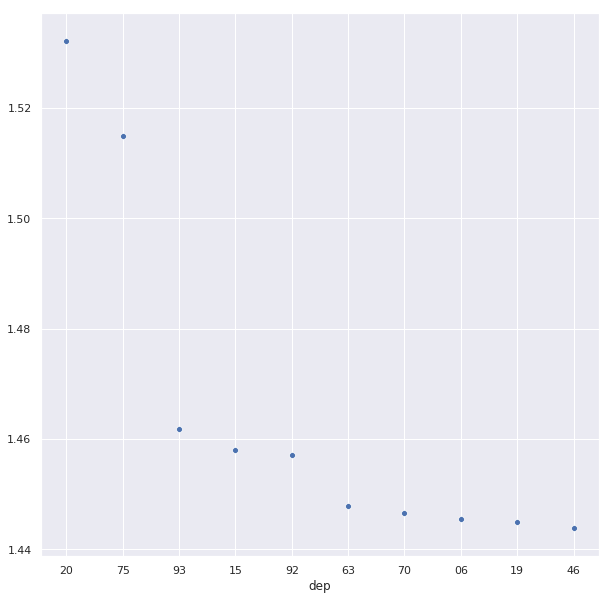

In [22]:
plt.figure(figsize=(10,10))
sns.scatterplot(top_10.index,top_10.values)

les départements de **l'ile de france** sont tres present dans ce top 10.

## Definir cinq categories de prix : Tres bas, bas, moyen, élevé, trés élevé

In [23]:
X = df.loc[:,["valeur"]]

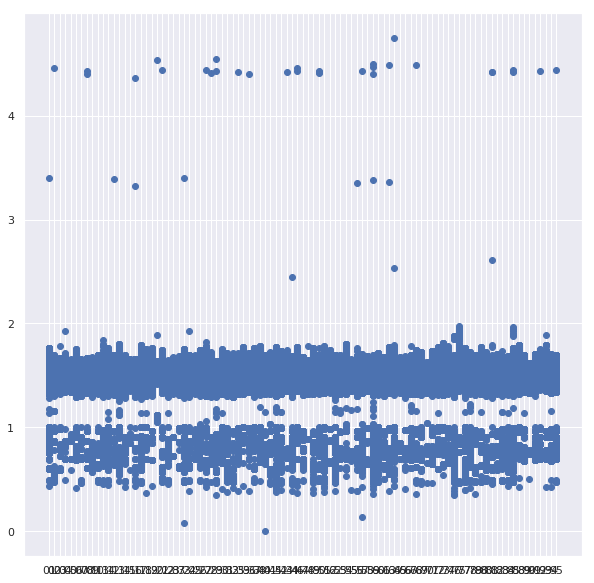

In [24]:
plt.figure(figsize=(10,10))
plt.scatter(df.dep, X.valeur)

déja là on peut définir une classe des prix abérants ceux qui ne sont pas entre 0,4 et 2 euros

cette décision est arbitraire mais elle vas nous permettre d'avoir un jeux de données plus correctes pour effectuer un clustering dessus

In [25]:
df["gamme_prix"] = np.nan

In [26]:
df.loc[~((df.valeur > 0.4) & (df.valeur < 2)),"gamme_prix"] = "aberant"

### Kmeans sur les prix pour definir 5 gammes de prix 

travailer sur la **df** sans les données aberantes 

In [27]:
df_no_aberant = df.loc[df.gamme_prix != "aberant",:]

definir un **X** sur lequel on fera le clustering (ici la valeur des prix)

**Attention :** le resultat du KMeans peut changer car depend d'une initialisation **random** et par consequent chaque execution peut différée de l'autre. <br>
Je fais **np.random.seed(123)** pour que les resultats de cette feuille soit toujours les même

In [28]:
np.random.seed(123)

In [29]:
X = df_no_aberant.loc[:,["valeur"]]
kmeans = KMeans(n_clusters=5)
kmeans.fit(X)
y_kmeans = kmeans.predict(X)

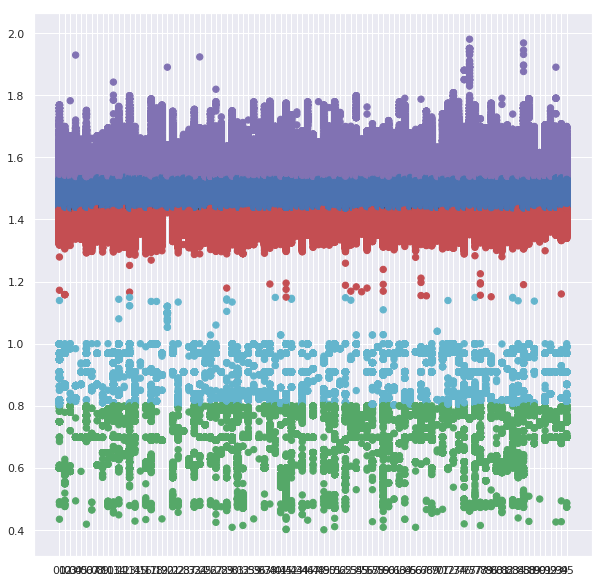

In [30]:
colormap=np.array(["b","g","r","c","m"])
plt.figure(figsize=(10,10))
plt.scatter(df_no_aberant.dep, X.valeur,c=colormap[y_kmeans],s=40)

In [31]:
df_no_aberant.loc[:,"gamme_prix"] = y_kmeans

/home/houcine/anaconda3/lib/python3.7/site-packages/pandas/core/indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


Le **KMeans** attribue un numéro à chaque groupe sans ordre particulier. Donc il faut qu'on regard la moyenne par groupe pour définir quel groupe coresond à quelle gamme

In [32]:
df_no_aberant.groupby("gamme_prix")["valeur"].mean().sort_values()

gamme_prix
1    0.702386
3    0.902991
2    1.395462
0    1.477046
4    1.595528
Name: valeur, dtype: float64

ici le **KMeans** m'a donnée le mapping suivant

In [33]:
mapping = {1:"tres bas",3:"bas",2:"moyen",0:"eleve",4:"tres eleve"}

In [34]:
df_no_aberant.gamme_prix = df_no_aberant.gamme_prix.replace(mapping)

/home/houcine/anaconda3/lib/python3.7/site-packages/pandas/core/generic.py:4405: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self[name] = value


In [35]:
df_no_aberant.gamme_prix

1000001     moyen
1000001     moyen
1000001     moyen
            ...  
95870009    eleve
95870009    eleve
95870009    eleve
Name: gamme_prix, Length: 799625, dtype: object

Mettre à jour la df originale

In [36]:
df.loc[~(df.gamme_prix=="aberant"),"gamme_prix"] = df_no_aberant.gamme_prix

In [37]:
df

,annee,nom,id,maj,valeur,cp,dep,gamme_prix
1000001,2019,Gazole,1,2019-01-04 10:53:48,1.328,01000,01,moyen
1000001,2019,Gazole,1,2019-01-07 10:25:25,1.348,01000,01,moyen
1000001,2019,Gazole,1,2019-01-10 08:54:28,1.374,01000,01,moyen
...,...,...,...,...,...,...,...,...
95870009,2019,SP98,6,2019-03-10 00:01:00,1.524,95870,95,eleve
95870009,2019,SP98,6,2019-03-11 00:01:00,1.524,95870,95,eleve
95870009,2019,SP98,6,2019-03-11 00:01:00,1.524,95870,95,eleve


## combiner les types de carburants et la gamme de prix

In [38]:
type_gamme_count = pd.DataFrame(df.groupby(["nom"])["gamme_prix"].value_counts())
type_gamme_count.columns=["nb"]
type_gamme_count = type_gamme_count.reset_index()

In [39]:
type_gamme_count

,nom,gamme_prix,nb
0,E10,moyen,129839
1,E10,eleve,54858
2,E10,tres eleve,16378
...,...,...,...
33,SP98,bas,21
34,SP98,tres bas,19
35,SP98,aberant,7


la ligne **33** s'interprete comme **"20 fois le prix du SP98 à été classé bas"**

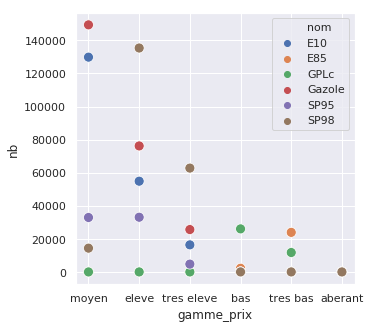

In [40]:
plt.figure(figsize=(5,5))
sns.scatterplot(type_gamme_count.gamme_prix, type_gamme_count.nb, hue=type_gamme_count.nom, s=100)

On retrouve que le **SP98** figure sur la gamme **eleve** et **tres eleve** et il dépasse tous les autres

Tandis que le **Gazole** et **E10** figurent plus sur la gamme **moyen**

Le **E85** et **GPLc** on les retrouve plus dans les gammes **bas** et **tres bas**

## Top 50 des points de vente qui ont eu le plus de prix élevés et tres élevés pour le **GAZOLE**

Aprés l'éxploration des gammes de prix combinées avec le type de carburant, on a remarqué que le **Gazole** est plutot un carburant de prix moyen. Mais on le retrouve pas mal de fois dans les gammes **elevé** et **trés elevé**.<br> Je soupçonne que le prix du **Gazole** peut être un bon indicateur pour detecter les points de ventes qui ont tendence de vendre cher.

In [41]:
df_gazol_count = pd.DataFrame(df.loc[df.nom == "Gazole",]
                              .reset_index()
                              .groupby('index')['gamme_prix']
                              .value_counts())
df_gazol_count.columns=["nb"]
df_gazol_count = df_gazol_count.reset_index()
df_gazol_count

,index,gamme_prix,nb
0,1000001,moyen,33
1,1000001,eleve,4
2,1000002,moyen,24
...,...,...,...
16411,95870005,tres eleve,4
16412,95870009,moyen,45
16413,95870009,eleve,26


On fait le top 50 des points de ventes qui vendent le **Gazole** dans trés cher

In [42]:
top_50 = df_gazol_count\
            .loc[(df_gazol_count.gamme_prix == "eleve") | (df_gazol_count.gamme_prix == "tres eleve")]\
            .sort_values(by='nb', ascending=False)[:50]
top_50

,index,gamme_prix,nb
16086,94250001,eleve,133
12747,75010003,eleve,133
16037,94110004,eleve,130
...,...,...,...
15860,93120004,tres eleve,71
12785,75015025,tres eleve,71
500,4130005,tres eleve,71


In [43]:
pdv_ids = top_50.loc[:,'index']

In [44]:
pdv_2019 = pdv.loc[pdv.annee=="2019",:]
top_50_geo_data = pdv_2019\
                    .loc[pdv_2019.id.isin(pdv_ids),["latitude","longitude"]]\
                    .dropna()
top_50_geo_data

,latitude,longitude
332,44.088080,6.221900
350,43.842886,5.851421
1199,43.315800,5.409380
...,...,...
12257,48.801010,2.340310
12298,48.813530,2.347750
12570,49.060040,2.347713


### Créer une carte interactive avec ***ipyleaflet*** pour explorer ces 50 pdv

pour cela il faut suivre ce [guide](https://ipyleaflet.readthedocs.io/en/latest/installation.html)

il faut installer npm et l'extension **"jupyter-leaflet"**

In [45]:
#!jupyter labextension install jupyter-leaflet

In [46]:
!jupyter nbextension enable --py --sys-prefix ipyleaflet

Enabling notebook extension jupyter-leaflet/extension...
      - Validating: OK


### Créer la carte interactive en y ajoutant les top 50 points de ventes qui vendent le **GAZOLE** cher

In [47]:
# centre de france
center = (46.6, 2.3)
# créeation de la carte
carte = Map(center=center, zoom=5)

# ajout des marker des points de ventes
for i in top_50_geo_data.index:
    position = tuple(top_50_geo_data.loc[i,:])
    marker = Marker(location=position, draggable=False)
    carte.add_layer(marker);
carte

Map(basemap={'url': 'https://{s}.tile.openstreetmap.org/{z}/{x}/{y}.png', 'max_zoom': 19, 'attribution': 'Map …

### ***DEMO :***

In [48]:
video = io.open('map/demo.mp4', 'r+b').read()
encoded = base64.b64encode(video)
HTML(data='''<video alt="test" controls>
                <source src="data:video/mp4;base64,{0}" type="video/mp4" />
             </video>'''.format(encoded.decode('ascii')))

### Captures d'écran de la carte : (au cas où ça ne fonctionne pas chez vous)

Ici on voit que la carte est centrée en France et les points de ventes apparaissent dessus

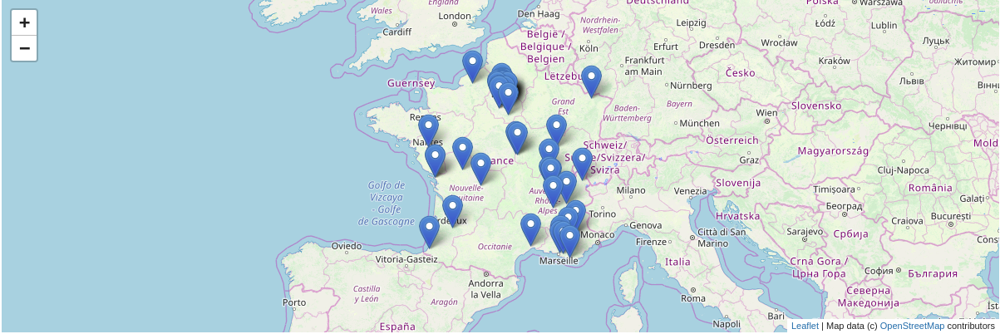

In [49]:
Image("map/01.png")

### Hypothéses sur le prix élevé

#### Premiére : Grandes villes

* **Paris**

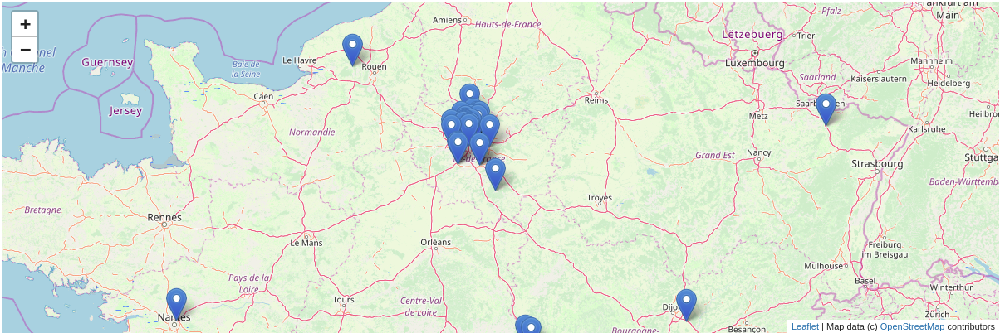

In [50]:
Image("map/02 paris.png")

* **Marseille et Lyon**

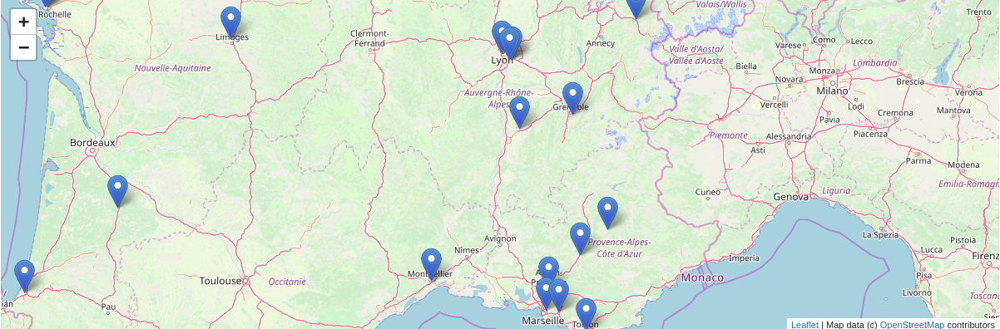

In [51]:
Image("map/03 sud.png")

#### Deuxiéme : Dans des autoroutes

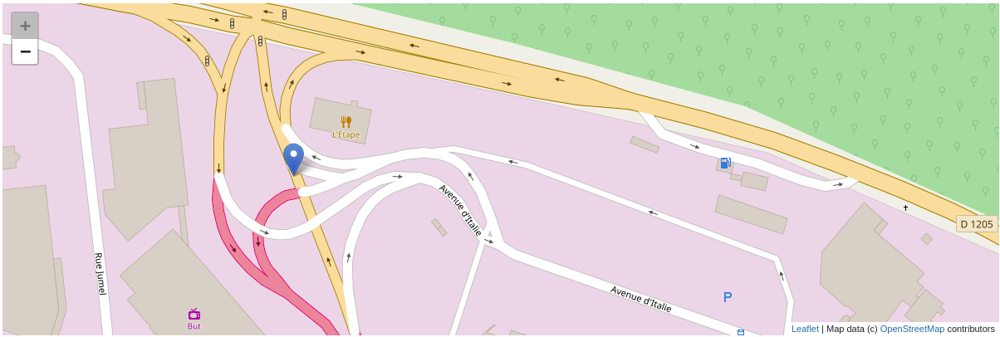

In [52]:
Image("map/04 autoroute aire de repos.png")

#### Troisiéme : Proximité des aeroports

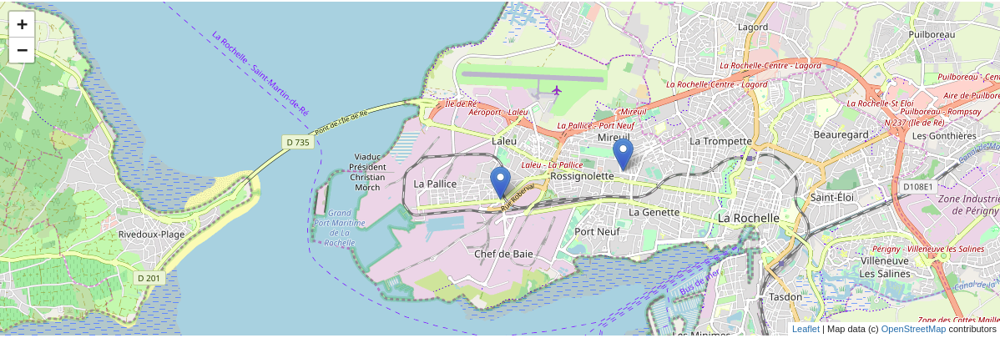

In [53]:
Image("map/05 prox aero.png")

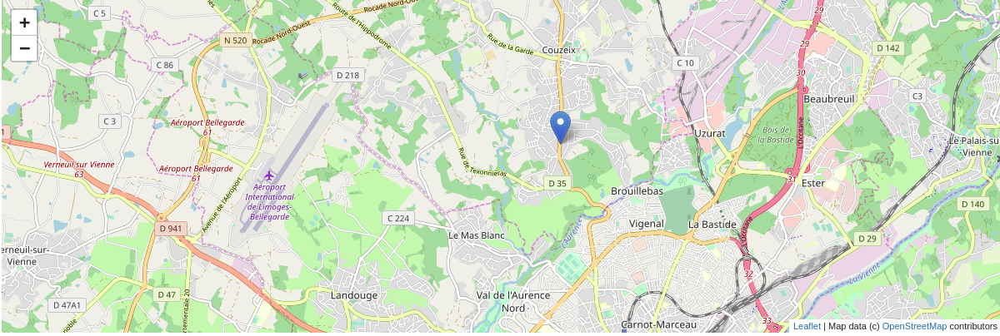

In [54]:
Image("map/05 prox aeroport.png")

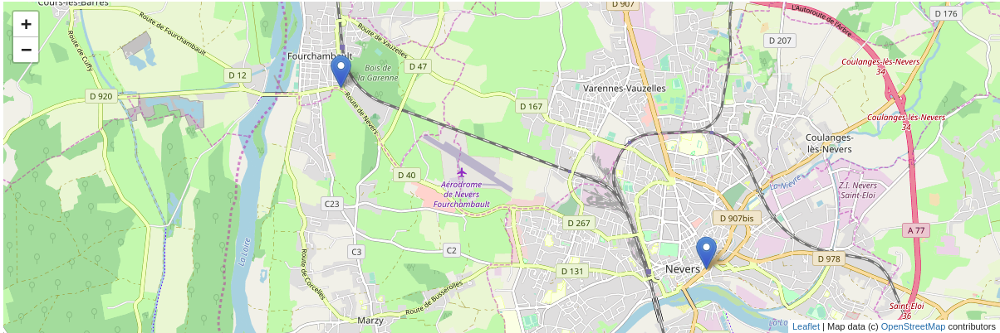

In [55]:
Image("map/05 proximite aeroport.png")

Ici on trouve que le point de vente est proche d'un aéroport et d'une autoroute européene

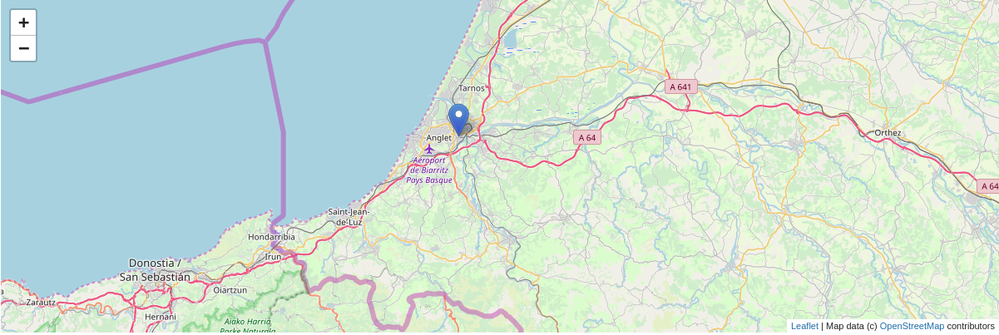

In [56]:
Image("map/06 prox aero et autoroute europe.png")